In [35]:
# Required Modules
import pandas as pd
import numpy as np
import lazypredict
import warnings
warnings.filterwarnings("ignore")

from scipy import stats

from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_log_error


from lazypredict.Supervised import LazyRegressor
from lazypredict.Supervised import LazyClassifier

from lightgbm import LGBMRegressor
from lightgbm import LGBMClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression

In [2]:
data = pd.read_csv('Resources/Final_Data.csv')
data.head()

,Zip_Code,Date,Year,Month,Sale_Price,Interest_Rate,Property_Tax,Rent_Price,Household_Income,Rent_Affordability,...,FTE_Employed,Unemployed,Expense_Index,Average_Commute,Crime_Index,Loan_Amount,Loan_Term,Loan_R,Loan_Payment,Home_Affordability
0,32003,2019-01-01,2019,1,244950.00,4.46,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,195960.00,360.00,1.00,988.71,0.13
1,32003,2019-02-01,2019,2,270000.00,4.37,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,216000.00,360.00,1.00,1077.82,0.14
2,32003,2019-03-01,2019,3,275000.00,4.26,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,220000.00,360.00,1.00,1084.20,0.14
3,32003,2019-04-01,2019,4,264500.00,4.14,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,211600.00,360.00,1.00,1027.67,0.13
4,32003,2019-05-01,2019,5,281000.00,4.07,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,224800.00,360.00,1.00,1082.58,0.14


In [3]:
ml_data = data[['Zip_Code', 'Year', 'Month', 'Mobility_Rate', 'Expense_Index', 'Crime_Index' , 'Total_Vacant', 'Total_Dwellings', 'Total_Sales', 'FHA_Count', 'Home_Affordability', 'Rent_Affordability', 'Sale_Price' ]]
# ml_data.index = ml_data['Zip_Code']
ml_data

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00


In [4]:
ml_data.dtypes

Zip_Code                int64
Year                    int64
Month                   int64
Mobility_Rate         float64
Expense_Index           int64
Crime_Index             int64
Total_Vacant            int64
Total_Dwellings         int64
Total_Sales             int64
FHA_Count               int64
Home_Affordability    float64
Rent_Affordability    float64
Sale_Price            float64
dtype: object

In [5]:
count = np.isinf(ml_data).values.sum()
print("It contains " + str(count) + " infinite values")

It contains 0 infinite values


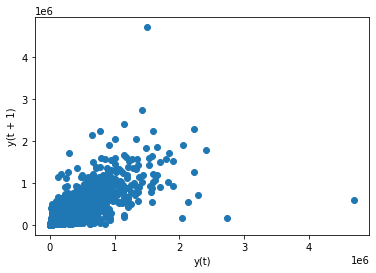

In [6]:
from pandas.plotting import lag_plot
lag_plot(ml_data)

In [20]:
ml_data_3mo = ml_data.sort_values(by = ['Zip_Code', 'Year', 'Month'], ascending = [True, True, True])
ml_data_3mo.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00


In [22]:
ml_data_3mo['Last_Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift()
ml_data_3mo['Last_2Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(2)
ml_data_3mo['Last_3Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(3)
# ml_data_3mo['Future_Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-1)
# ml_data_3mo['Future_2Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-2)
# ml_data_3mo['Future_3Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-3)


price_difference_1 = []
price_difference_2 = []
price_difference_3 = []


for column in ml_data_3mo[['Sale_Price', 'Last_Month_Price', 'Last_2Month_Price',
                    'Last_3Month_Price']]:
   # Select column contents by column name using [] operator
    current_sales = ml_data_3mo['Sale_Price'].values
    last_sales = ml_data_3mo['Last_Month_Price'].values
    last_2mo_sale = ml_data_3mo['Last_2Month_Price'].values
    last_3mo_sale = ml_data_3mo['Last_3Month_Price'].values
    price_difference_1.append(current_sales-last_sales)
    price_difference_2.append(last_sales-last_2mo_sale)
    price_difference_3.append(last_2mo_sale-last_3mo_sale)
    

ml_data_3mo['Last_Month_Diff'] = price_difference_1[0]
ml_data_3mo['Last_2Month_Diff'] = price_difference_2[0]
ml_data_3mo['Last_3Month_Diff'] = price_difference_3[0]

ml_data_3mo

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00,nan,nan,nan,nan,nan,nan
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00,244950.00,nan,nan,25050.00,nan,nan
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,nan,5000.00,25050.00,nan
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [23]:
ml_data_3mo.replace([np.inf, -np.inf], np.nan, inplace=True)
ml_data_3mo.dropna(inplace=True)
ml_data_3mo.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,32003,2019,6,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,32003,2019,7,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,32003,2019,8,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [24]:
predict_21 = ml_data_3mo[ml_data_3mo['Year'] == 2021]

predict_21

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,32003,2021,1,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,32003,2021,2,0.18,104,28,704,11724,30,8,0.14,0.14,333800.00,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,32003,2021,3,0.18,104,28,704,11724,70,4,0.15,0.14,339950.00,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,32008,2021,1,0.07,82,118,964,3247,6,0,0.15,0.29,132000.00,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,32008,2021,2,0.07,82,118,964,3247,3,1,0.06,0.29,53200.00,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [25]:
predict_21 = predict_21.drop(columns=['Zip_Code', 'Year', 'Month'])
predict_21

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,0.18,104,28,704,11724,30,8,0.14,0.14,333800.00,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,0.18,104,28,704,11724,70,4,0.15,0.14,339950.00,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,0.07,82,118,964,3247,6,0,0.15,0.29,132000.00,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,0.07,82,118,964,3247,3,1,0.06,0.29,53200.00,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [26]:
y_test = predict_21['Sale_Price'].values

X_test = predict_21.drop(columns='Sale_Price')

feature_test_names = X_test.columns

X_test

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,0.18,104,28,704,11724,39,6,0.12,0.14,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,0.18,104,28,704,11724,30,8,0.14,0.14,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,0.18,104,28,704,11724,70,4,0.15,0.14,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,0.07,82,118,964,3247,6,0,0.15,0.29,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,0.07,82,118,964,3247,3,1,0.06,0.29,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,0.14,91,113,2976,21551,116,7,0.20,0.25,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,0.14,91,113,2976,21551,7,12,0.42,0.25,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [27]:
ml_data_3mo = ml_data_3mo[ml_data_3mo['Year'] < 2021]
ml_data_3mo.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,32003,2019,6,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,32003,2019,7,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,32003,2019,8,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [28]:
# ml_data_3mo = ml_data_3mo.drop(columns=['Zip_Code', 'Year', 'Month', 'Last_Month_Price',
#                         'Last_2Month_Price', 'Last_2Month_Price', 'Last_Month_Diff',
#                         'Last_2Month_Diff', 'Last_3Month_Price', 'Last_3Month_Diff'])
# ml_data_3mo

ml_data_3mo = ml_data_3mo.drop(columns=['Zip_Code', 'Year', 'Month'])
ml_data_3mo

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24371,0.14,91,113,2976,21551,139,17,0.19,0.25,285000.00,285000.00,256000.00,256000.00,0.00,29000.00,0.00
24372,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,285000.00,285000.00,256000.00,-25250.00,0.00,29000.00
24373,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,259750.00,285000.00,285000.00,0.00,-25250.00,0.00
24374,0.14,91,113,2976,21551,142,16,0.20,0.25,297000.00,259750.00,259750.00,285000.00,37250.00,0.00,-25250.00


In [29]:
y_train= ml_data_3mo['Sale_Price'].values

X_train = ml_data_3mo.drop(columns='Sale_Price')

feature_train_names = X_train.columns

X_train

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,0.18,104,28,704,11724,42,3,0.13,0.14,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,0.18,104,28,704,11724,64,5,0.13,0.14,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24371,0.14,91,113,2976,21551,139,17,0.19,0.25,285000.00,256000.00,256000.00,0.00,29000.00,0.00
24372,0.14,91,113,2976,21551,132,11,0.17,0.25,285000.00,285000.00,256000.00,-25250.00,0.00,29000.00
24373,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,285000.00,285000.00,0.00,-25250.00,0.00
24374,0.14,91,113,2976,21551,142,16,0.20,0.25,259750.00,259750.00,285000.00,37250.00,0.00,-25250.00


# Random Forest Regressor

In [30]:
#Random Forest Regressor
rf_regr = RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=42)
rf_regr.fit(X_train, y_train)

RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=42)

In [31]:
print(f"Training Data Score: {rf_regr.score(X_train, y_train)}")
print(f"Testing Data Score: {rf_regr.score(X_test, y_test)}")

Training Data Score: 0.998261590175127
Testing Data Score: 0.9783895595652402


In [32]:
def rmsle(ytrue, ypred):
    return np.sqrt(mean_squared_log_error(ytrue, ypred))

In [36]:
rf_pred = rf_regr.predict(X_test)

error = rmsle(y_test, rf_pred)
    
print('Mean Error = %.5f' % np.mean(error))

Mean Error = 0.07033


In [37]:
output = pd.DataFrame({'Predicted':rf_pred, 'Actual': y_test})
output

,Predicted,Actual
0,300614.62,299900.00
1,333581.20,333800.00
2,339494.40,339950.00
3,132370.02,132000.00
4,65174.46,53200.00
...,...,...
2612,305592.64,305000.00
2613,300558.48,300000.00
2614,300017.08,300000.00
2615,537985.57,599000.00


In [72]:
from sklearn.model_selection import GridSearchCV
param_grid = {'n_estimators': [100, 500, 1000,]}
grid = GridSearchCV(rf_regr, param_grid, verbose=3)
grid

GridSearchCV(estimator=RandomForestRegressor(n_estimators=1000, n_jobs=-1,
                                             random_state=42),
             param_grid={'n_estimators': [100, 500, 1000]}, verbose=3)

In [73]:
grid.fit(X_train, y_train)

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV] n_estimators=100 ................................................
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[CV] .................... n_estimators=100, score=0.985, total=   2.3s
[CV] n_estimators=100 ................................................
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s
[CV] .................... n_estimators=100, score=0.996, total=   0.9s
[CV] n_estimators=100 ................................................
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    3.2s remaining:    0.0s
[CV] .................... n_estimators=100, score=0.933, total=   0.9s
[CV] n_estimators=100 ................................................
[CV] .................... n_estimators=100, score=0.931, total=   0.9s
[CV] n_estimators=100 ................................................
[CV] .................... n_estimators=100, score=0.969, tot

GridSearchCV(estimator=RandomForestRegressor(n_estimators=1000, n_jobs=-1,
                                             random_state=42),
             param_grid={'n_estimators': [100, 500, 1000]}, verbose=3)

In [74]:
print(grid.best_params_)

{'n_estimators': 1000}


# VAR

In [105]:
var_data = ml_data.sort_values(by = ['Zip_Code', 'Year', 'Month'], ascending = [True, True, True])
var_data = var_data.set_index('Zip_Code')
var_data.head()

,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
Zip_Code,,,,,,,,,,,,
32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00


In [204]:
var_data_slim = var_data.loc[32603].drop(columns=['Year', 'Month', 'Mobility_Rate', 'Expense_Index', 
                    'Crime_Index', 'Total_Vacant', 'Total_Dwellings', 'Rent_Affordability', 
                    'Home_Affordability'])
var_data_slim

,Total_Sales,FHA_Count,Sale_Price
Zip_Code,,,
32603,5,0,270000.00
32603,1,0,246500.00
32603,5,0,207500.00
32603,6,0,260000.00
32603,9,0,280000.00
32603,1,0,310000.00
32603,4,0,311750.00
32603,1,0,187400.00
32603,4,0,262500.00


In [205]:
# from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.vector_ar.var_model import VAR

X = var_data_slim.values

train= X[:24]
test = X[24:]


In [206]:
ar_model = VAR(endog=train)
ar_model_fit = ar_model.fit()

In [207]:
prediction = ar_model_fit.forecast(ar_model_fit.y, steps=len(test))

In [208]:
from math import sqrt
columns = ['Total_Sales', 'FHA_Count', 'Sale_Price']
pred = pd.DataFrame(index=range(0,len(prediction)),columns=columns)
for j in range(0,3):
    for i in range(0, len(prediction)):
       pred.iloc[i][j] = prediction[i][j]


pred[['Total_Sales', 'FHA_Count', 'Sale_Price']] = pred[['Total_Sales', 'FHA_Count', 
                                            'Sale_Price']].astype(int)

rmse_ts = []
rmse_fha = []
rmse_sp = []

for column in pred[['Total_Sales', 'FHA_Count', 'Sale_Price']]:
    ts = pred['Total_Sales'].values
    fha = pred['FHA_Count'].values
    sp = pred['Sale_Price'].values

pred.head()

,Total_Sales,FHA_Count,Sale_Price
0,1,0,331129
1,3,0,282437
2,3,0,286675


In [213]:
# err_df = pd.DataFrame(index=range(0,len(prediction), columns={'test': test, 'predict': prediction})
# err_df
err_df = pd.DataFrame(test)
err_df.rename(columns = {0: 'Testing_Sales', 1: 'Testing_Count', 2:'Testing_Price'}, inplace=True)

pred_df = pd.DataFrame(prediction)
pred_df.rename(columns = {0: 'Prediction_Sales', 1: 'Prediction_Count', 2:'Prediction_Price'}, inplace=True)

err_df['Prediction_Sales'] = pred_df['Prediction_Sales']
err_df['Prediction_Count'] = pred_df['Prediction_Count']
err_df['Prediction_Price'] = pred_df['Prediction_Price']
err_df

,Testing_Sales,Testing_Count,Testing_Price,Prediction_Sales,Prediction_Count,Prediction_Price
0,2.00,0.00,327100.00,1.40,0.00,331129.27
1,1.00,0.00,235000.00,3.10,0.00,282437.66
2,5.00,0.00,355000.00,3.87,0.00,286675.98


In [214]:
sales_mean_error = []
count_mean_error = []
price_mean_error = []


for column in err_df[['Testing_Sales', 'Testing_Count', 'Testing_Price',
                    'Prediction_Sales', 'Prediction_Count', 'Prediction_Price']]:
   
   # Select column contents by column name using [] operator
    testing_sales = err_df['Testing_Sales'].values
    pred_sales = err_df['Prediction_Sales'].values
    testing_count = err_df['Testing_Count'].values
    pred_count = err_df['Prediction_Count'].values
    testing_price = err_df['Testing_Price'].values
    pred_price = err_df['Prediction_Price'].values
    sales_mean_error.append(np.sqrt(mean_squared_log_error(testing_sales, pred_sales)))
    count_mean_error.append(np.sqrt(mean_squared_log_error(testing_count, pred_count)))
    price_mean_error.append(np.sqrt(mean_squared_log_error(testing_price, pred_price)))
    

err_df['Sales_Mean_Error'] = sales_mean_error[0]
err_df['Count_Mean_Error'] = count_mean_error[0]
err_df['Price_Mean_Error'] = price_mean_error[0]

err_df

,Testing_Sales,Testing_Count,Testing_Price,Prediction_Sales,Prediction_Count,Prediction_Price,Sales_Mean_Error,Count_Mean_Error,Price_Mean_Error
0,2.00,0.00,327100.00,1.40,0.00,331129.27,0.45,0.00,0.16
1,1.00,0.00,235000.00,3.10,0.00,282437.66,0.45,0.00,0.16
2,5.00,0.00,355000.00,3.87,0.00,286675.98,0.45,0.00,0.16


In [200]:
error = rmsle(test, prediction)
    
print('Mean Error = %.5f' % np.mean(error))

Mean Error = 0.67840


# ARIMA MultiVariant

In [49]:
import tensorflow
from tensorflow.keras.layers import LSTM

from sklearn.model_selection import KFold, cross_val_score, train_test_split

In [19]:
arima_data = ml_data.sort_values(by = ['Zip_Code', 'Year', 'Month'], ascending = [True, True, True])
arima_data.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00


In [39]:
arima_data['Last_Month_Price'] = arima_data.groupby(['Zip_Code'])['Sale_Price'].shift()
arima_data['Last_2Month_Price'] = arima_data.groupby(['Zip_Code'])['Sale_Price'].shift(2)
arima_data['Last_3Month_Price'] = arima_data.groupby(['Zip_Code'])['Sale_Price'].shift(3)

price_difference_1 = []
price_difference_2 = []
price_difference_3 = []

for column in arima_data[['Sale_Price', 'Last_Month_Price', 'Last_2Month_Price',
                    'Last_3Month_Price']]:
   # Select column contents by column name using [] operator
    current_sales = arima_data['Sale_Price'].values
    last_sales = arima_data['Last_Month_Price'].values
    last_2mo_sale = arima_data['Last_2Month_Price'].values
    last_3mo_sale = arima_data['Last_3Month_Price'].values
    price_difference_1.append(current_sales-last_sales)
    price_difference_2.append(last_sales-last_2mo_sale)
    price_difference_3.append(last_2mo_sale-last_3mo_sale)
    

arima_data['Last_Month_Diff'] = price_difference_1[0]
arima_data['Last_2Month_Diff'] = price_difference_2[0]
arima_data['Last_3Month_Diff'] = price_difference_3[0]

arima_data

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00,nan,nan,nan,nan,nan,nan
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00,244950.00,nan,nan,25050.00,nan,nan
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,nan,5000.00,25050.00,nan
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [56]:
arima_data.replace([np.inf, -np.inf], np.nan, inplace=True)
arima_data.dropna(inplace=True)
arima_data.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,32003,2019,6,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,32003,2019,7,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,32003,2019,8,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [52]:
import statsmodels.formula.api as smf

model = smf.ols(formula = 'Last_Month_Diff ~ Last_2Month_Diff + Last_3Month_Diff', data=arima_data)

model_fit = model.fit()
regression_adj_rsq = model_fit.rsquared_adj
print(regression_adj_rsq)

0.30634541463960585


In [57]:
predict_21 = arima_data[arima_data['Year'] == 2021]
predict_21 = predict_21.drop(columns=['Zip_Code', 'Year', 'Month'])
predict_21.head()

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,0.18,104,28,704,11724,30,8,0.14,0.14,333800.00,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,0.18,104,28,704,11724,70,4,0.15,0.14,339950.00,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,0.07,82,118,964,3247,6,0,0.15,0.29,132000.00,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,0.07,82,118,964,3247,3,1,0.06,0.29,53200.00,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00


In [58]:
arima_train = arima_data[arima_data['Year']<2021]
arima_train = arima_train.drop(columns=['Zip_Code', 'Year', 'Month'])
arima_train.head()

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [97]:
import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.graphics.api import qqplot

In [98]:
arima_model = ARMA(endog=arima_data['Sale_Price'], exog=arima_data['Last_Month_Diff'], 
            order=(1,1)).fit()
print(arima_model.summary())

/Users/jjwilliams/anaconda3/envs/PythonData/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:214: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
                              ARMA Model Results                              
Dep. Variable:             Sale_Price   No. Observations:                21666
Model:                     ARMA(1, 1)   Log Likelihood             -267225.057
Method:                       css-mle   S.D. of innovations          54987.510
Date:                Wed, 02 Jun 2021   AIC                         534460.114
Time:                        14:37:52   BIC                         534500.032
Sample:                             0   HQIC                        534473.123
                                                                              
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------

<IPython.core.display.Javascript object>

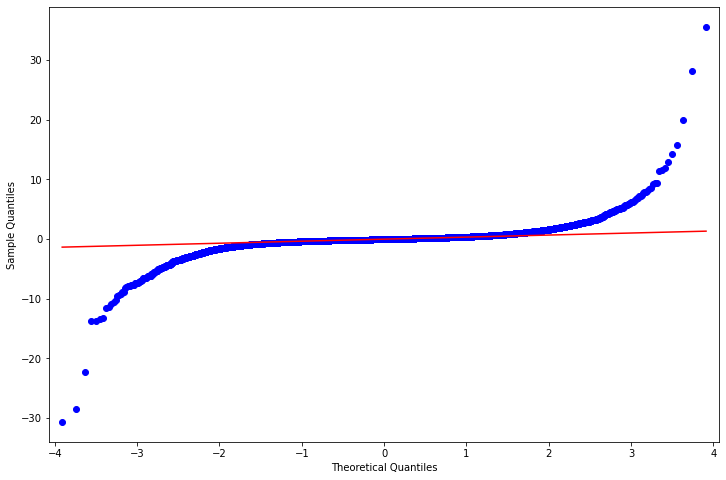

In [99]:
resid = arima_model.resid
stats.normaltest(resid)
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
fig = qqplot(resid, line='q', ax=ax, fit=True)